In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.special as sp
import os as os
import multiprocessing
from joblib import Parallel, delayed
from time import time as ti
from skimage.restoration import denoise_wavelet
import pickle
#import CoreFunctions as cf
import sys
import random
import psutil

In [2]:
DataFolder = '/sciclone/scr10/dchendrickson01/Recordings2/'
DataFolder = '/scratch/Recordings2/'

TIME_STEPS = 1200
Skips = 125
RollSize = 50

tic = ti()
start = tic

MemoryProtection = True

LR_Starting = 3e-2
LR_PeriodGrow = 6
LR_Decay = .75
LR_Expand = 3.75

In [3]:
RunTwice = True

In [4]:
FilesPerRun = 12
ConcurrentFiles = 6

In [5]:
def RollingStdDevFaster(RawData, SmoothData, RollSize = 25):

    Diffs = RawData - SmoothData
    del RawData, SmoothData
    
    Sqs = Diffs * Diffs
    del Diffs
    
    Sqs = Sqs.tolist() 
    Sqs.extend(np.zeros(RollSize))
    mSqs = np.matrix(Sqs)
    
    for i in range(RollSize):
        Sqs.insert(0, Sqs.pop())
        mSqs = np.concatenate((np.matrix(Sqs),mSqs))
    
    sVect = mSqs.sum(axis=0)
    eVect = (mSqs!=0).sum(axis=0)
    del mSqs, Sqs
    
    VarVect = sVect / eVect
    StdDevs = np.sqrt(VarVect)
    return np.asarray(StdDevs[:-RollSize].T)

def SquelchPattern(DataSet, StallRange = 5000, SquelchLevel = 0.02, verbose = False):
    
    SquelchSignal = np.ones(len(DataSet))
    if verbose:
        print(len(SquelchSignal))
        
    for i in range(len(DataSet)-2*StallRange):
        if np.average(DataSet[i:i+StallRange]) < SquelchLevel:
            SquelchSignal[i+StallRange]=0

    return SquelchSignal

def split_list_by_zeros(original_list, ones_list):
    # modified split_list_by_ones function to instead split by the zeros.
    #
    #
    # Created with Bing AI support
    #  1st request: "python split list into chunks based on value"
    #  2nd request: "I want to split the list based on the values in a second list.  Second list is all 1s and 0s.  I want all 0s removed, and each set of consequtive ones as its own item"
    #  3rd request: "That is close.  Here is an example of the two lists, and what I would want returned: original_list = [1, 2, 3, 8, 7, 4, 5, 6, 4, 7, 8, 9]
    #                ones_list =     [1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1]
    #                return: [[1, 2, 3, 8], [4, 5, 6], [8,9]]"
    #
    #This is the function that was created and seems to work on the short lists, going to use for long lists
    
    result_sublists = []
    sublist = []

    for val, is_one in zip(original_list, ones_list):
        if not is_one:
            sublist.append(val)
        elif sublist:
            result_sublists.append(sublist)
            sublist = []

    # Add the last sublist (if any)
    if sublist:
        result_sublists.append(sublist)

    return result_sublists

# Generated training sequences for use in the model.
def create_sequences(values, time_steps=TIME_STEPS, skips = Skips):
    output = []
    for i in range(int((len(values) - time_steps + skips)/skips)):
        output.append(values[i*skips : (i*skips + time_steps)])
    return np.stack(output)

In [6]:
def runFile(file, verbose = False, small = False, index=0, start=ti()):
    noise = verbose
    if file[-4:] == '.csv':    
        dataset = pd.read_csv(DataFolder+file, delimiter =",", header=None, engine='python',on_bad_lines='skip')
        if noise:
            print("File Read", ti()-start)
        dataset = dataset.rename(columns={0:"Day"})
        dataset = dataset.rename(columns={1:"Second"})
        dataset = dataset.rename(columns={2:"FracSec"})
        dataset = dataset.rename(columns={3:"p"})
        dataset = dataset.rename(columns={4:"h"})
        dataset = dataset.rename(columns={5:"v"})
        dataset = dataset.rename(columns={6:"Sensor"})

        dataset['Second'].replace('',0)
        dataset['FracSec'].replace('',0)
        dataset.replace([np.nan, np.inf, -np.inf],0,inplace=True)
        
        dataset[['Day','Second']] = dataset[['Day','Second']].apply(lambda x: x.astype(int).astype(str).str.zfill(6))
        dataset[['FracSec']] = dataset[['FracSec']].apply(lambda x: x.astype(int).astype(str).str.zfill(4))

        dataset["timestamp"] = pd.to_datetime(dataset.Day+dataset.Second+dataset.FracSec,format='%y%m%d%H%M%S%f')
        dataset["timestamps"] = dataset["timestamp"]

        dataset["p"] = dataset.p - np.average(dataset.p)
        dataset["h"] = dataset.h - np.average(dataset.h)
        dataset["v"] = dataset.v - np.average(dataset.v)
        dataset["r"] = np.sqrt(dataset.p**2 + dataset.h**2 + dataset.v**2)

        dataset.index = dataset.timestamp

        dataset["SmoothP"] = denoise_wavelet(dataset.p, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        dataset["SmoothH"] = denoise_wavelet(dataset.h, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        dataset["SmoothV"] = denoise_wavelet(dataset.v, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        dataset["SmoothR"] = denoise_wavelet(dataset.r, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')

        if noise:
            print("Data Cleaned", ti()-start, len(dataset.p))

        RawData = dataset.v
        SmoothData = dataset.SmoothV
        RollSize = 25

        Diffs = RawData - SmoothData

        Sqs = Diffs * Diffs

        Sqs = Sqs.tolist() 

        Sqs.extend(np.zeros(RollSize))

        mSqs = np.matrix(Sqs)

        for i in range(RollSize):
            Sqs.insert(0, Sqs.pop())
            mSqs = np.concatenate((np.matrix(Sqs),mSqs))

        sVect = mSqs.sum(axis=0)
        eVect = (mSqs!=0).sum(axis=0)

        VarVect = sVect / eVect

        StdDevs = np.sqrt(VarVect)

        StdDevsZ = np.asarray(StdDevs)

        StdDevsZ=np.append(StdDevsZ,[0])

        StdDevsZ = np.asarray(StdDevsZ.T[:len(dataset.p)])

        if noise:
            print("Size StdDevsZ", ti()-start, np.shape(StdDevsZ))

        #StdDevsZ = np.nan_to_num(StdDevsZ)

        #StdDevsZ[StdDevsZ == np.inf] = 0
        #StdDevsZ[StdDevsZ == -np.inf] = 0

        if noise:
            print("cleaned", ti()-start, np.shape(StdDevsZ))

        SmoothDevZ = denoise_wavelet(StdDevsZ, method='VisuShrink', mode='soft', wavelet='sym2', rescale_sigma='True')

        if noise:
            print("denoise 1", ti()-start, np.shape(StdDevsZ))

        #SmoothDevZa = cf.Smoothing(StdDevsZ, 3, wvt='sym2', dets_to_remove=2, levels=3)
        #SmoothDevZ = np.ravel(SmoothDevZ[0,:])

        #SmoothDevZ = SmoothDevZ.tolist()

        if noise:
            print("denoise 2", ti()-start, np.shape(SmoothDevZ))

        #ataset["SmoothDevZ"] = SmoothDevZ

        SmoothDevZ[np.isnan(SmoothDevZ)]=0
        
        Max = np.max(SmoothDevZ)

        
        
        if noise:
            print("Max", ti()-start, np.shape(Max), Max)

        buckets = int(Max / 0.005) + 1
        bins = np.linspace(0,buckets*0.005,buckets+1)
        counts, bins = np.histogram(SmoothDevZ,bins=bins)

        CummCount = 0
        HalfWay = 0
        for i in range(len(counts)):
            CummCount += counts[i]
            if CummCount / len(SmoothDevZ) >= 0.5:
                if HalfWay == 0:
                    HalfWay = i

        SquelchLevel = bins[HalfWay] 
        if noise:
            print("SmoothDevz size", np.shape(SmoothDevZ))

        dataset["IsMoving"] = SquelchPattern(SmoothDevZ, 4000, SquelchLevel, verbose=noise)

        if noise:
            print("Squelch Made", ti()-start)
        #dataset["velocity"] = getVelocity(dataset.p, dataset.FracSec, dataset.IsMoving, 2)
        #if noise:
        #    print("Velocity Calculated.  File done: ",file)

        #df_pr = split_list_by_ones(dataset.p, dataset.IsMoving)
        #df_hr = split_list_by_ones(dataset.h, dataset.IsMoving)
        #df_vr = split_list_by_ones(dataset.v, dataset.IsMoving)
        #df_rrr = split_list_by_ones(dataset.r, dataset.IsMoving)
        df_ps = split_list_by_zeros(dataset.SmoothP, dataset.IsMoving)
        df_hs = split_list_by_zeros(dataset.SmoothH, dataset.IsMoving)
        df_vs = split_list_by_zeros(dataset.SmoothV, dataset.IsMoving)
        df_rs = split_list_by_zeros(dataset.SmoothR, dataset.IsMoving)

        del dataset
        
        MatsSmooth = []
        for i in range(len(df_ps)):
            MatsSmooth.append(np.vstack((df_ps[i],df_hs[i],df_vs[i],df_rs[i])))
        
        if verbose:
            print("Split by ones", ti()-start)


        '''df_p=[0]
        df_h=[0]
        df_v=[0]
        df_r=[0]
        df_rp=[0]
        df_rh=[0]
        df_rv=[0]
        df_rr=[0]
        for i in range(len(df_ps)):
            df_p += df_ps[i]
            df_h += df_hs[i]
            df_v += df_vs[i]
            df_r += df_rs[i]
            df_rp += df_pr[i]
            df_rh += df_hr[i]
            df_rv += df_vr[i]
            df_rr += df_rrr[i]
        '''
        if verbose:
            print('format changed', ti()-start, len(MatsSmooth))

        return MatsSmooth
    else:
        return ['fail','fail']
        
        #if verbose:
        #    print('Data normalized', ti()-start)

        #return df_p, df_h, df_v, df_r, df_rp, df_rh, df_rv, df_rr


In [7]:
files= os.listdir(DataFolder) 

In [8]:
random.shuffle(files)

In [9]:
%%time
#df_p, df_h, df_v, df_r, 
Mats = runFile(files[5], verbose = True, small = False, index=0, start=ti())

File Read 0.052468061447143555
Data Cleaned 0.11344790458679199 2058
Size StdDevsZ 0.11615967750549316 (2058,)
cleaned 0.1161806583404541 (2058,)
denoise 1 0.11687445640563965 (2058,)
denoise 2 0.11689567565917969 (2058,)
Max 0.11691951751708984 () 0.2731239261793842
SmoothDevz size (2058,)
2058
Squelch Made 0.11843299865722656
Split by ones 0.11949276924133301
format changed 0.11950516700744629 0
CPU times: user 33 ms, sys: 7.36 ms, total: 40.4 ms
Wall time: 120 ms


In [10]:
def runWrapper(file, verbose = True, small = False, index=0, start=ti()):
    try:
        rtrn = runFile(file, verbose, small, index, start)
        return rtrn
    except:
        return np.zeros((10,10,3))

In [11]:
%%time
AllDatas = Parallel(n_jobs=ConcurrentFiles)(delayed(runWrapper)(files[(i+8)*7], False, False, 0, ti()) for i in range(FilesPerRun))

CPU times: user 621 ms, sys: 2.64 s, total: 3.26 s
Wall time: 10min 50s


In [12]:
for fileResponse in AllDatas:
    for Mat in fileResponse:
        Mats.append(Mat)

In [13]:
len(Mats)

6553

In [14]:
import CoreFunctions as cf

In [15]:
lengths = []
rejects = []
Keeps = []

In [16]:
for Mat in Mats:
    spm = np.shape(Mat)
    if len(spm) > 1:
        lenM = spm[1]
    else:
        lenM = 1
    if (lenM > 1250):
        lengths.append(lenM)
        Keeps.append(Mat)
    else:
        rejects.append(lenM)

In [17]:
if MemoryProtection:
    print('RAM memory % used:', psutil.virtual_memory()[2])
    del Mats, AllDatas


RAM memory % used: 4.1


In [18]:
len(lengths) / (len(lengths)+len(rejects))

0.3106973905081642

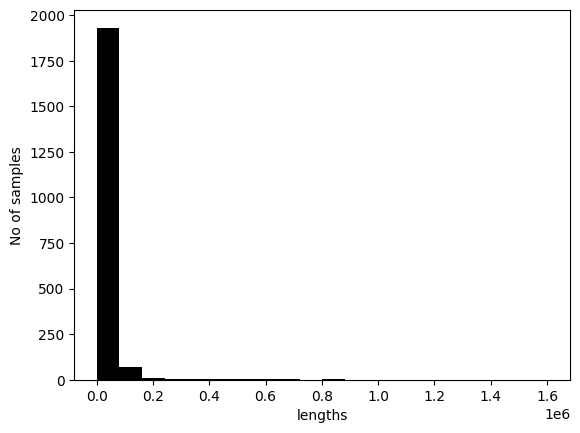

In [19]:
plt.hist(lengths, bins=20)
plt.xlabel("lengths")
plt.ylabel("No of samples")
plt.show()


In [20]:
Prints = []


In [21]:
np.shape(Keeps[3])

(4, 34478)

In [22]:
def PrintWrap(Mat):
    localPrints = []
    lenm = np.shape(Mat)[1]
    slices = int(lenm/TIME_STEPS)
    for i in range(slices):
        temp = (cf.makeMPFast(Mat[:3,i*TIME_STEPS:(i+1)*TIME_STEPS], wvt = 'sym4', scales = 32, spacer = 2, title = ''))
        localPrints.append(temp.astype(np.float32)/255.0)
    return localPrints

In [23]:
%%time
AllPrints = Parallel(n_jobs=8)(delayed(PrintWrap)(Mat) for Mat in Keeps)

CPU times: user 6.97 s, sys: 33.6 s, total: 40.6 s
Wall time: 1min 22s


In [24]:
if MemoryProtection:
    print('RAM memory % used:', psutil.virtual_memory()[2])
    del Keeps

RAM memory % used: 19.7


In [25]:
for group in AllPrints:
    for fprint in group:
        Prints.append(fprint[:, ::2, :])

for Mat in Keeps:
    lenm = np.shape(Mat)[1]
    slices = int(lenm/TIME_STEPS)
    for i in range(slices):
        temp = (cf.makeMPFast(Mat[:3,i*TIME_STEPS:(i+1)*TIME_STEPS], wvt = 'sym4', scales = 60, spacer = 1, title = ''))
        Prints.append(temp.astype(np.float32)/255.0)

In [26]:
if MemoryProtection:
    print('RAM memory % used:', psutil.virtual_memory()[2])
    del AllPrints


RAM memory % used: 19.4


np.shape(Prints)

In [27]:
len(Prints)

40658

In [28]:
np.max(Prints[1])

1.0

In [29]:
for i in range(7):
    print(np.shape(Prints[i*13]))

(32, 600, 3)
(32, 600, 3)
(32, 600, 3)
(32, 600, 3)
(32, 600, 3)
(32, 600, 3)
(32, 600, 3)


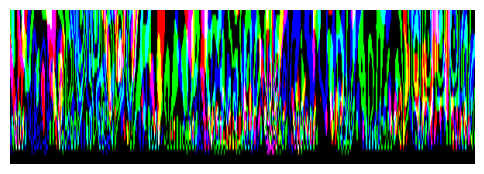

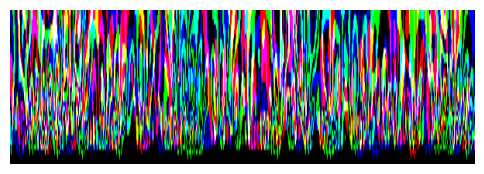

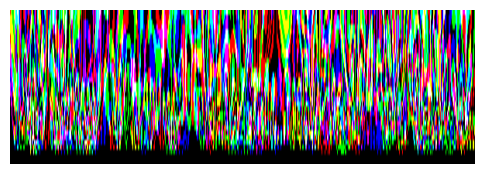

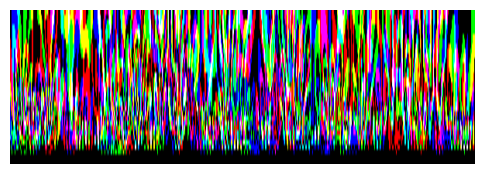

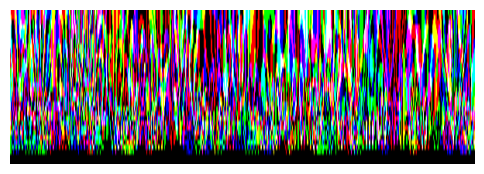

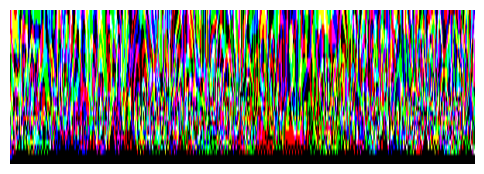

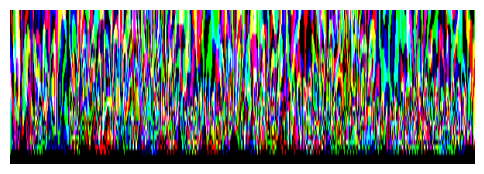

In [30]:
for i in range(7):
    fig = plt.figure(figsize=(6,2), dpi=100)
    plt.axis("off")
    plt.imshow(Prints[i*13], origin='lower',aspect='auto')
    plt.show()

# Start Machine Learning
## Using Autoencoder with Kears and Tensorflow
cite: https://pyimagesearch.com/2020/02/17/autoencoders-with-keras-tensorflow-and-deep-learning/

In [31]:
# import the necessary packages
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Reshape
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
import numpy as np

2024-10-02 13:30:12.182849: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-02 13:30:12.449348: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-02 13:30:12.522194: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-02 13:30:13.058500: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [32]:
class ConvAutoencoder:
    @staticmethod
    def build(width, height, depth, filters=(32, 64), latentDim=24):
        inputShape = (height, width, depth)
        chanDim = -1
        inputs = Input(shape=inputShape)
        x = inputs

        for f in filters:
            x = Conv2D(f, (3, 3), strides=2, padding="same")(x)
            x = LeakyReLU(alpha=0.2)(x)
            x = BatchNormalization(axis=chanDim)(x)

        volumeSize = K.int_shape(x)
        print("Volume Size:", volumeSize)
        x = Flatten()(x)
        latent = Dense(latentDim)(x)

        encoder = Model(inputs, latent, name="encoder")

        latentInputs = Input(shape=(latentDim,))
        flattenedVolumeSize = int(np.prod(volumeSize[1:]))
        print("Flattened Volume Size:", flattenedVolumeSize)
        x = Dense(flattenedVolumeSize)(latentInputs)
        x = Reshape((volumeSize[1], volumeSize[2], volumeSize[3]))(x)

        for f in filters[::-1]:
            x = Conv2DTranspose(f, (3, 3), strides=2, padding="same")(x)
            x = LeakyReLU(alpha=0.2)(x)
            x = BatchNormalization(axis=chanDim)(x)

        x = Conv2DTranspose(depth, (3, 3), padding="same")(x)
        outputs = Activation("sigmoid")(x)

        decoder = Model(latentInputs, outputs, name="decoder")
        autoencoder = Model(inputs, decoder(encoder(inputs)), name="autoencoder")

        return (encoder, decoder, autoencoder)


In [33]:
# set the matplotlib backend so figures can be saved in the background
import matplotlib
matplotlib.use("Agg")
# import the necessary packages
#from pyimagesearch.convautoencoder import ConvAutoencoder
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.datasets import mnist
import matplotlib.pyplot as plt
import numpy as np
import argparse
import cv2
# construct the argument parse and parse the arguments

In [34]:
import random
import tensorflow as tf

In [35]:
from tensorflow.keras.callbacks import Callback

In [36]:
import keras

In [37]:
# initialize the number of epochs to train for and batch size
EPOCHS = 25
BS = 128
TestSplit = 10 # 1/this many

# load the MNIST dataset

random.shuffle(Prints)

TestLength = int(len(Prints)/TestSplit)

In [38]:
np.shape(Prints)

(40658, 32, 600, 3)

In [39]:
print(type(Prints))
print(Prints[0].dtype)
print(np.shape(Prints))
print('RAM memory % used:', psutil.virtual_memory()[2])

<class 'list'>
float32
(40658, 32, 600, 3)
RAM memory % used: 19.5



# Assuming 'Prints' is your list

# Convert the list to a NumPy array with a consistent data type
try:
    prints_array = np.array(Prints, dtype=np.float32)
except Exception as e:
    print(f"Error converting to NumPy array: {e}")

# Check the shape and type of the NumPy array
print(f"Shape of prints_array: {prints_array.shape}")
print(f"Data type of prints_array: {prints_array.dtype}")

# Convert the NumPy array to a TensorFlow tensor
try:
    tensor_prints = tf.convert_to_tensor(prints_array)
    print(tensor_prints)
except Exception as e:
    print(f"Error converting to TensorFlow tensor: {e}")


In [40]:
for i, image in enumerate(Prints):
    if not isinstance(image, np.ndarray):
        Prints[i] = np.array(image, dtype=np.float32)
    elif image.dtype != np.float32:
        Prints[i] = image.astype(np.float32)

# Stack the images into a single NumPy array
prints_array = np.stack(Prints, axis=0)

if MemoryProtection:
    del Prints
    print('RAM memory % used:', psutil.virtual_memory()[2])

RAM memory % used: 26.3


In [41]:
if psutil.virtual_memory()[2] > 49:
    temp = (float(psutil.virtual_memory()[2]) - 50.0) / 50.0
    temp2 = int(np.shape(prints_array)[0]*temp)
    prints_array = prints_array[:temp2]

In [42]:
np.shape(prints_array)

(40658, 32, 600, 3)

In [43]:
# Convert the NumPy array to a TensorFlow tensor
tensor_prints = tf.convert_to_tensor(prints_array)

2024-10-02 13:30:52.607481: I tensorflow/core/common_runtime/gpu/gpu_device.cc:2021] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43598 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:21:00.0, compute capability: 8.6
2024-10-02 13:30:52.609192: I tensorflow/core/common_runtime/gpu/gpu_device.cc:2021] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 43598 MB memory:  -> device: 1, name: NVIDIA A40, pci bus id: 0000:81:00.0, compute capability: 8.6
2024-10-02 13:30:52.612997: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 9367603200 exceeds 10% of free system memory.


In [44]:
ImageShape = np.shape(tensor_prints)

In [45]:
if MemoryProtection:
    del prints_array
    print('RAM memory % used:', psutil.virtual_memory()[2])

RAM memory % used: 26.5


NP = []
for prt in Prints:
    temp = tf.convert_to_tensor(prt)
    NP.append(temp)
NP = tf.onvert_to_tensor(NP)

trainX = np.asarray(Prints[:TestLength]).astype('float32')

testX = Prints[TestLength:]

In [46]:
trX = tensor_prints[:TestLength]  #tf.convert_to_tensor(trainX, dtype=tf.float32)

In [47]:
teX = tensor_prints[TestLength:]  #tf.convert_to_tensor(testX, dtype=tf.float32)

In [48]:
if MemoryProtection:
    del tensor_prints

In [49]:
# construct our convolutional autoencoder
print("[INFO] building autoencoder...")

[INFO] building autoencoder...


In [50]:
(encoder, decoder, autoencoder) = ConvAutoencoder.build(ImageShape[2], ImageShape[1], ImageShape[3],(64,32),32)

Volume Size: (None, 8, 150, 32)
Flattened Volume Size: 38400


/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [51]:
print(encoder.summary())
print(decoder.summary())
print(autoencoder.summary())

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 32, 600, 3)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 16, 300, 64)    │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 16, 300, 64)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 16, 300, 64)    │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 8, 150, 32)     │        18,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 8, 150, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 8, 150, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 38400)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 32)             │     1,228,832 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,249,472 (4.77 MB)

 Trainable params: 1,249,280 (4.77 MB)

 Non-trainable params: 192 (768.00 B)

None


Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 38400)          │     1,267,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 150, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 300, 32)    │         9,248 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 16, 300, 32)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 16, 300, 32)    │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 600, 64)    │        18,496 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 600, 64)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 32, 600, 64)    │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 32, 600, 3)     │         1,731 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 32, 600, 3)     │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,297,059 (4.95 MB)

 Trainable params: 1,296,867 (4.95 MB)

 Non-trainable params: 192 (768.00 B)

None


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 32, 600, 3)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 32)             │     1,249,472 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 32, 600, 3)     │     1,297,059 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,546,531 (9.71 MB)

 Trainable params: 2,546,147 (9.71 MB)

 Non-trainable params: 384 (1.50 KB)

None


In [52]:
opt = Adam(learning_rate=LR_Starting)
autoencoder.compile(loss="mse", optimizer=opt)
# train the convolutional autoencoder

In [53]:

class CustomModelCheckpoint(Callback):
    def __init__(self, filepath, save_freq):
        super(CustomModelCheckpoint, self).__init__()
        self.filepath = filepath
        self.save_freq = save_freq

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.save_freq == 0:
            self.model.save(self.filepath.format(epoch=epoch + 1))

In [54]:
checkpoint_callback = CustomModelCheckpoint(
    filepath='/scratch/models/3DFP_1001{epoch:02d}.keras',
    save_freq=3  
)

tb_callback = tf.keras.callbacks.TensorBoard(log_dir='/scratch/models/profiles/0927',
                                            profile_batch='01, 125')

es_callback = keras.callbacks.EarlyStopping(monitor="loss", patience=6, mode="min")

2024-10-02 13:30:57.960729: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:103] Profiler session initializing.
2024-10-02 13:30:57.960775: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:118] Profiler session started.
2024-10-02 13:30:57.960808: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:892] Profiler found 2 GPUs
2024-10-02 13:30:58.030595: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:130] Profiler session tear down.
2024-10-02 13:30:58.030694: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:1036] CUPTI activity buffer flushed


In [55]:
H = autoencoder.fit(
	trX, trX,
	validation_data=(teX, teX),
	epochs=25,
    callbacks=[checkpoint_callback, es_callback],     
	batch_size=BS*2)

Epoch 1/25


I0000 00:00:1727890261.407932  333110 service.cc:146] XLA service 0x151b4020b630 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1727890261.407959  333110 service.cc:154]   StreamExecutor device (0): NVIDIA A40, Compute Capability 8.6
I0000 00:00:1727890261.407962  333110 service.cc:154]   StreamExecutor device (1): NVIDIA A40, Compute Capability 8.6
2024-10-02 13:31:01.500705: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-10-02 13:31:01.792029: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8906


 2/16 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - loss: 0.3117

I0000 00:00:1727890274.231876  333110 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - loss: 0.2758

2024-10-02 13:31:16.541441: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_1568', 4 bytes spill stores, 4 bytes spill loads



16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 784ms/step - loss: 0.2739

2024-10-02 13:31:26.104274: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 8431027200 exceeds 10% of free system memory.


16/16 ━━━━━━━━━━━━━━━━━━━━ 38s 1s/step - loss: 0.2723 - val_loss: 0.4089
Epoch 2/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 7s 428ms/step - loss: 0.2140 - val_loss: 0.4759
Epoch 3/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 7s 442ms/step - loss: 0.2117 - val_loss: 0.4592
Epoch 4/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 7s 427ms/step - loss: 0.2113 - val_loss: 0.3734
Epoch 5/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 6s 419ms/step - loss: 0.2112 - val_loss: 0.3227
Epoch 6/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 7s 444ms/step - loss: 0.2113 - val_loss: 0.2854
Epoch 7/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 6s 414ms/step - loss: 0.2111 - val_loss: 0.2600
Epoch 8/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 6s 419ms/step - loss: 0.2111 - val_loss: 0.2436
Epoch 9/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 7s 429ms/step - loss: 0.2112 - val_loss: 0.2320
Epoch 10/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 6s 414ms/step - loss: 0.2108 - val_loss: 0.2249
Epoch 11/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 6s 413ms/step - loss: 0.2109 - val_loss: 0.2209
Epoch 12/25
16/16 ━━━━━━━━━━━━━━━━━━━━ 7s 439ms/step - loss: 0.21

In [56]:
plt.plot(H.history["loss"], label="Training Loss")
plt.plot(H.history["val_loss"], label="Validation Loss")
plt.legend()
plt.show()

In [57]:
x_train_pred = autoencoder.predict(teX[:1000])

32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step


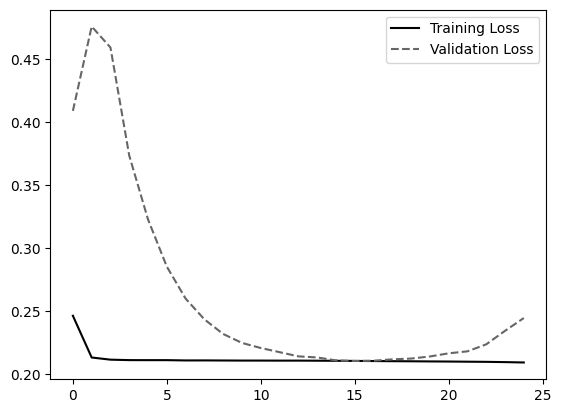

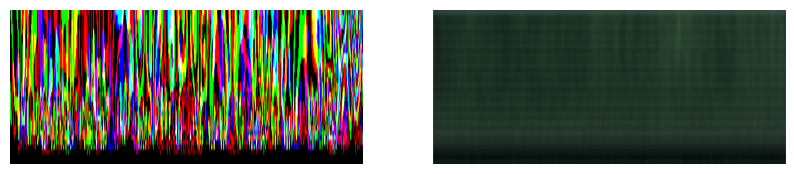

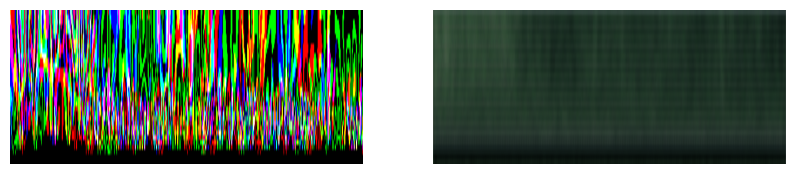

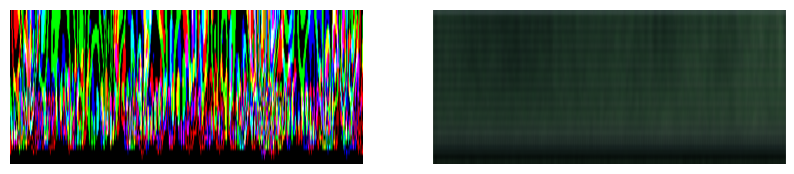

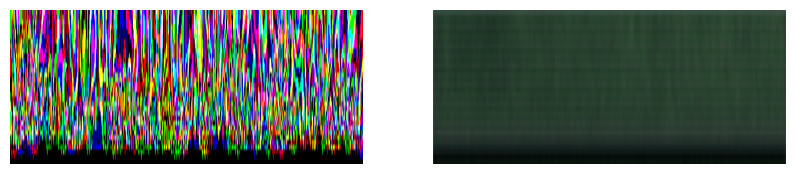

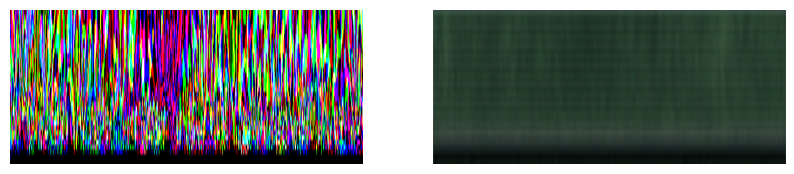

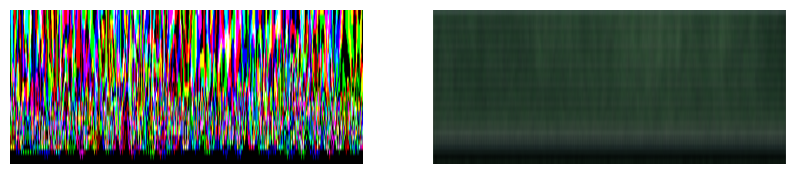

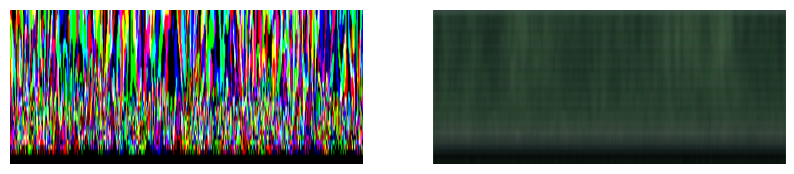

In [58]:
%matplotlib inline
for i in range(7):
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(10,2), dpi=100 )
    ax1.imshow(teX[i*13], origin='lower',aspect='auto')
    ax1.axis("off")
    ax2.imshow(x_train_pred[i*13], origin='lower',aspect='auto')
    plt.axis("off")
    plt.show()

In [59]:
del trX, teX

In [60]:
del x_train_pred

In [61]:
toc = ti()
LR_Current = LR_Starting

Loops Needed: 88
RAM after AllData: 12.9
RAM after Keeps: 21.1
RAM after Prints: 25.1
Epoch 1/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 21s 80ms/step - loss: 0.2061 - val_loss: 0.2063
Epoch 2/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 9s 52ms/step - loss: 0.2048 - val_loss: 0.2050
Epoch 3/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 9s 52ms/step - loss: 0.2042 - val_loss: 0.2042
Epoch 4/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 9s 52ms/step - loss: 0.2037 - val_loss: 0.2047
Epoch 5/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 8s 51ms/step - loss: 0.2034 - val_loss: 0.2050
Epoch 6/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 9s 52ms/step - loss: 0.2032 - val_loss: 0.2036
Epoch 7/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 8s 51ms/step - loss: 0.2029 - val_loss: 0.2037
Epoch 8/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 8s 51ms/step - loss: 0.2024 - val_loss: 0.2039
Epoch 9/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 9s 52ms/step - loss: 0.2023 - val_loss: 0.2031
Epoch 10/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 9s 51ms/step - loss: 0.2022 - val_loss: 0.2029
Epoch 11/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 9

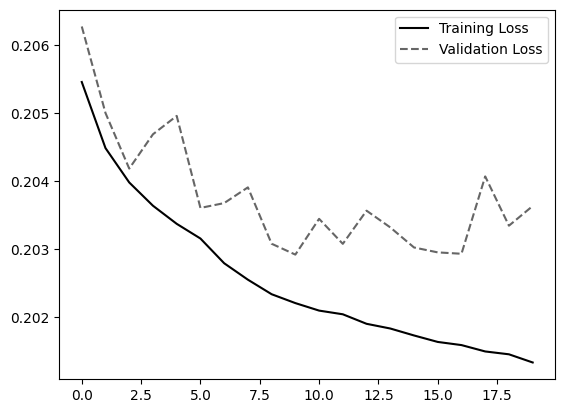

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step


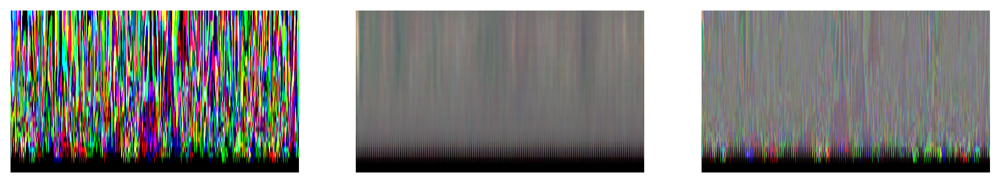

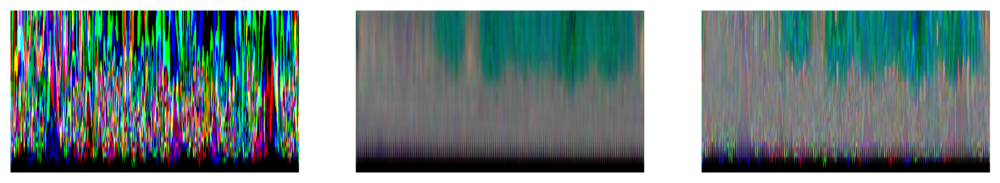

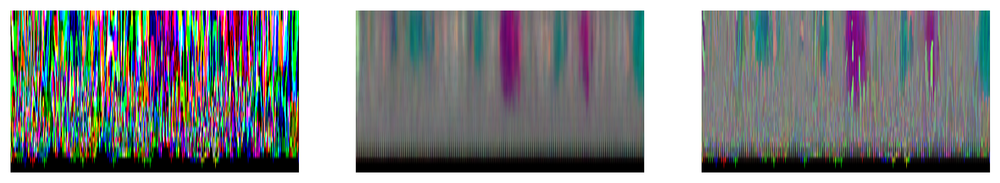

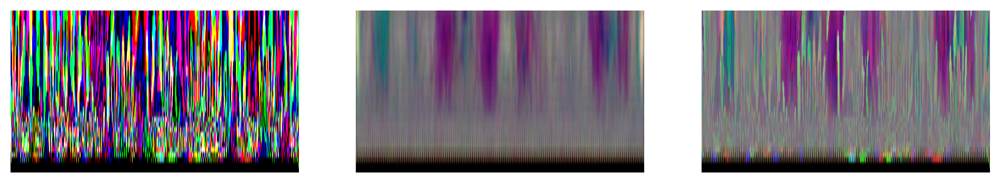

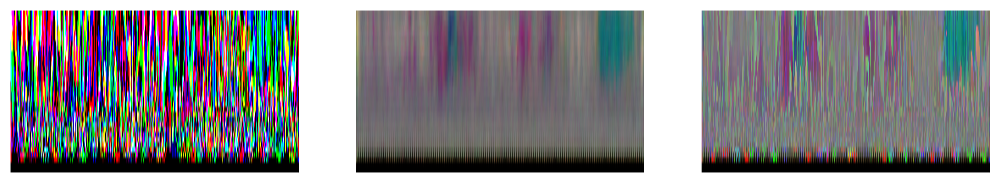

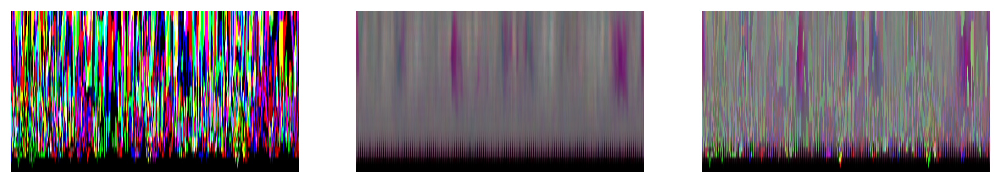

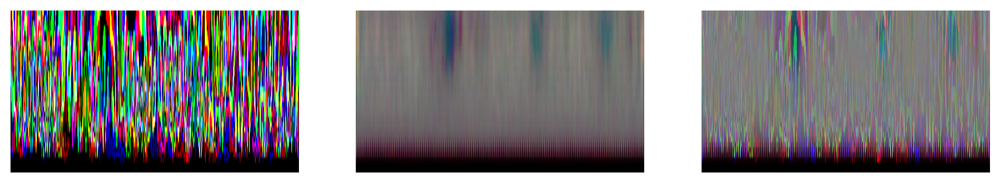

1 of 88 in 13.25 minutes. Using 41.5 of RAM
RAM after AllData: 44.7
RAM after Keeps: 42.0
RAM after Prints: 45.9
Epoch 1/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 16s 100ms/step - loss: 0.2010 - val_loss: 0.2017
Epoch 2/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 8s 52ms/step - loss: 0.2010 - val_loss: 0.2018
Epoch 3/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 9s 53ms/step - loss: 0.2009 - val_loss: 0.2019
Epoch 4/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 9s 53ms/step - loss: 0.2007 - val_loss: 0.2027
Epoch 5/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 8s 52ms/step - loss: 0.2007 - val_loss: 0.2024
Epoch 6/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 8s 52ms/step - loss: 0.2008 - val_loss: 0.2024
Epoch 7/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 8s 52ms/step - loss: 0.2004 - val_loss: 0.2024
Epoch 8/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 9s 53ms/step - loss: 0.2000 - val_loss: 0.2026
Epoch 9/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 9s 53ms/step - loss: 0.2006 - val_loss: 0.2028
Epoch 10/20
161/161 ━━━━━━━━━━━━━━━━━━━━ 8s 52ms/step - loss: 0.2002 - val_loss: 0.2029
Epoch 11/20
16

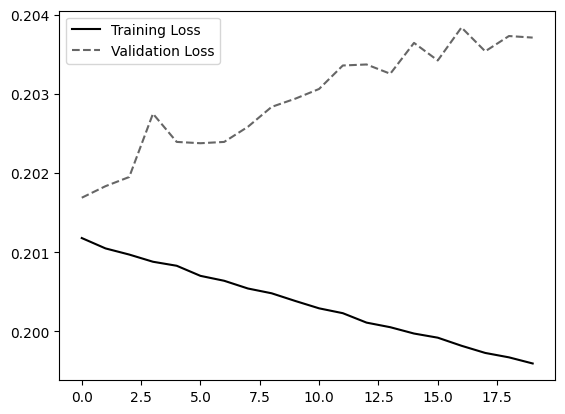

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


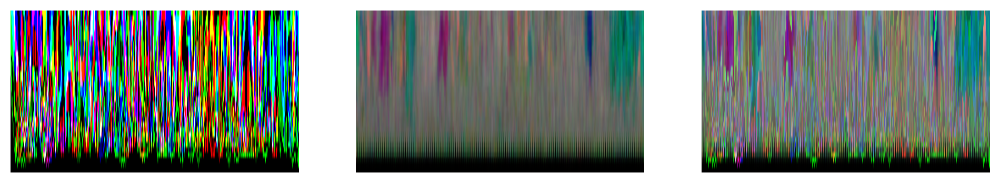

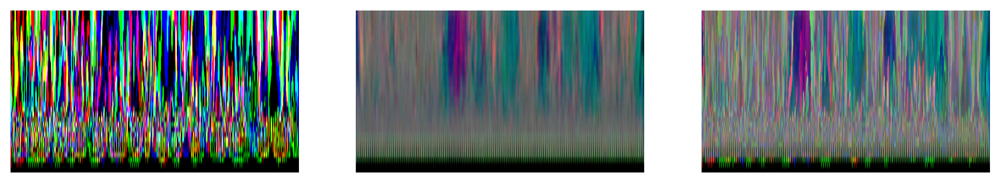

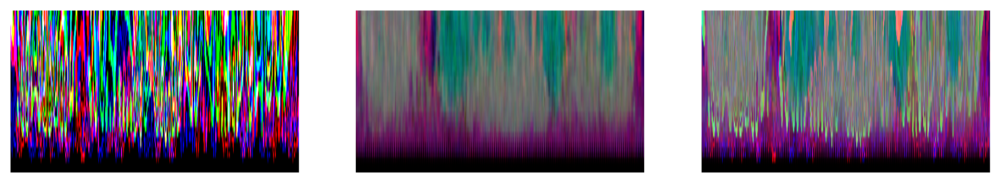

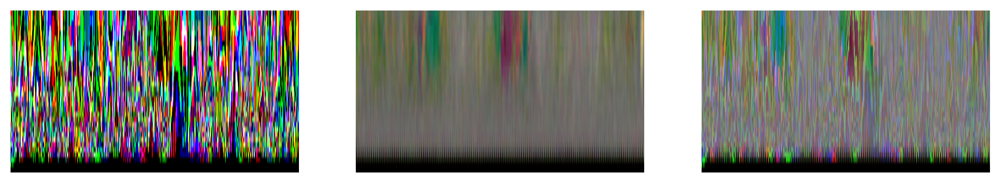

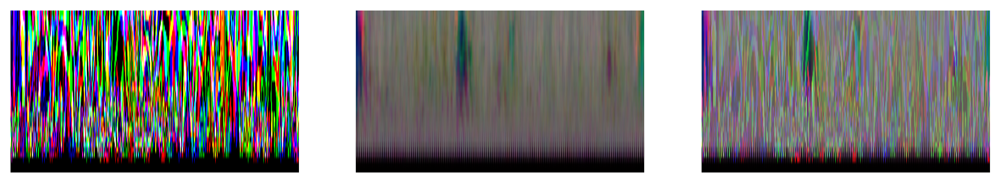

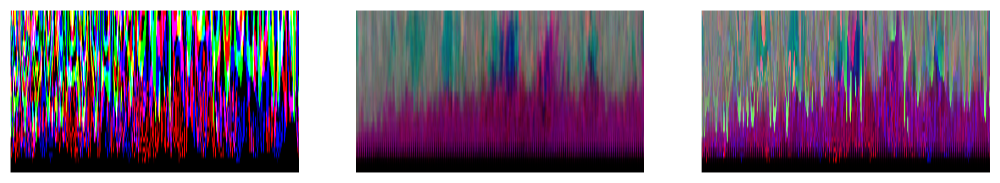

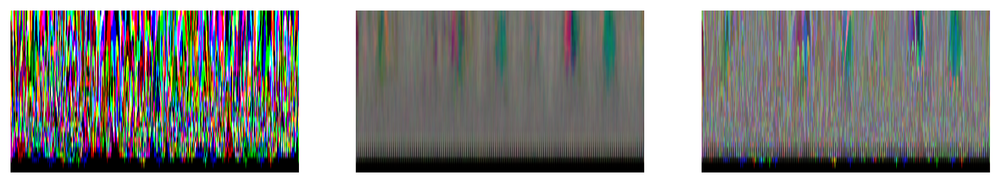

2 of 88 in 27.8 minutes. Using 47.8 of RAM
RAM after AllData: 45.0
RAM after Keeps: 45.1
RAM after Prints: 48.2
Epoch 1/20
126/126 ━━━━━━━━━━━━━━━━━━━━ 17s 133ms/step - loss: 0.2015 - val_loss: 0.2020
Epoch 2/20
126/126 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - loss: 0.2007 - val_loss: 0.2021
Epoch 3/20
126/126 ━━━━━━━━━━━━━━━━━━━━ 7s 55ms/step - loss: 0.2006 - val_loss: 0.2022
Epoch 4/20
126/126 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - loss: 0.2004 - val_loss: 0.2029
Epoch 5/20
126/126 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - loss: 0.2004 - val_loss: 0.2028
Epoch 6/20
126/126 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - loss: 0.2001 - val_loss: 0.2032


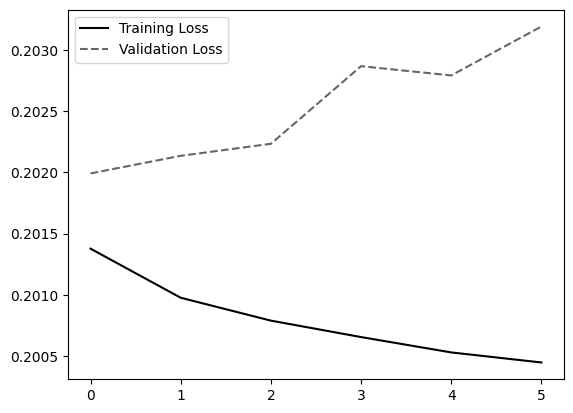

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


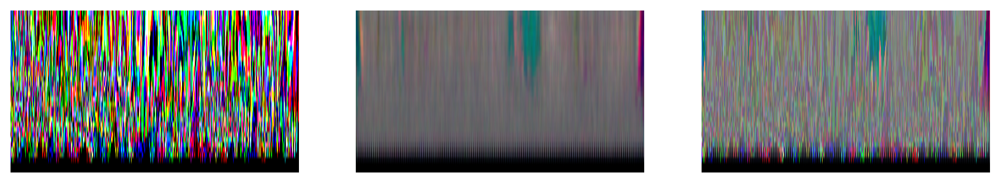

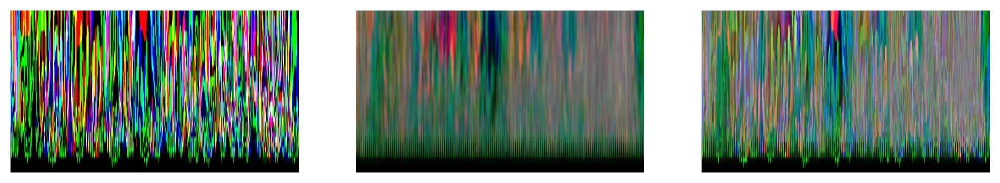

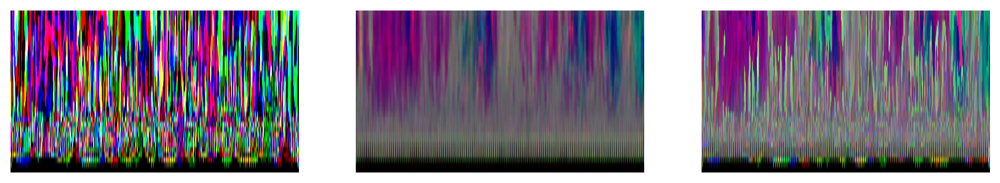

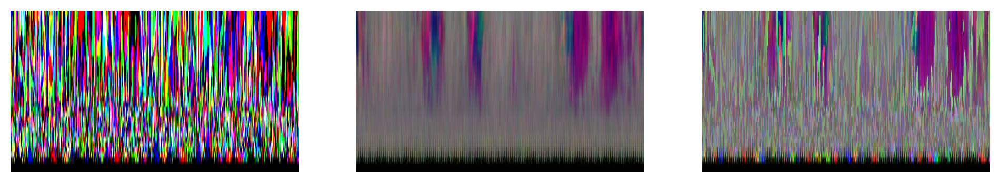

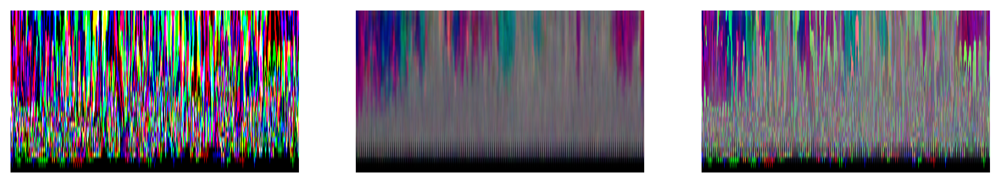

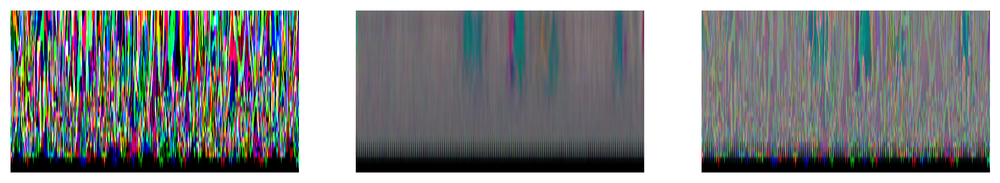

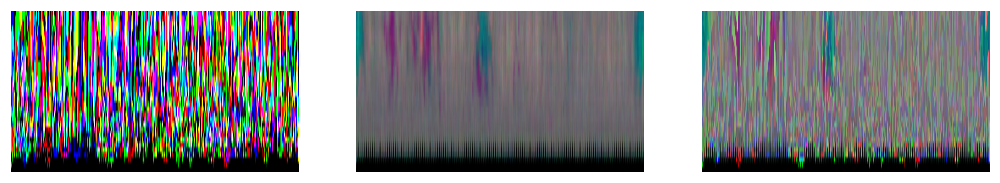

3 of 88 in 42.09 minutes. Using 47.7 of RAM
RAM after AllData: 48.1
RAM after Keeps: 48.0
RAM after Prints: 52.2
Epoch 1/20
179/179 ━━━━━━━━━━━━━━━━━━━━ 16s 86ms/step - loss: 0.2032 - val_loss: 0.2030
Epoch 2/20
179/179 ━━━━━━━━━━━━━━━━━━━━ 9s 51ms/step - loss: 0.2030 - val_loss: 0.2032
Epoch 3/20
179/179 ━━━━━━━━━━━━━━━━━━━━ 10s 53ms/step - loss: 0.2030 - val_loss: 0.2035
Epoch 4/20
179/179 ━━━━━━━━━━━━━━━━━━━━ 9s 52ms/step - loss: 0.2026 - val_loss: 0.2035
Epoch 5/20
179/179 ━━━━━━━━━━━━━━━━━━━━ 9s 52ms/step - loss: 0.2026 - val_loss: 0.2037
Epoch 6/20
179/179 ━━━━━━━━━━━━━━━━━━━━ 9s 53ms/step - loss: 0.2027 - val_loss: 0.2040


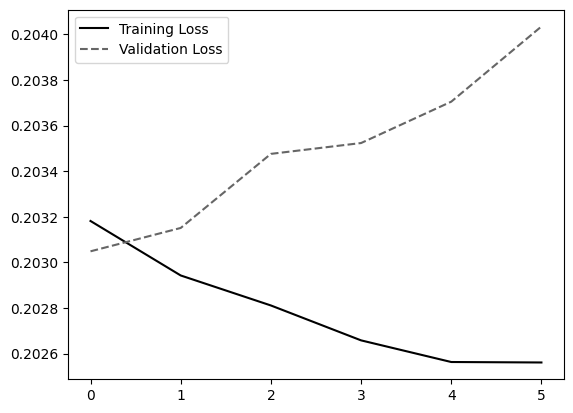

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


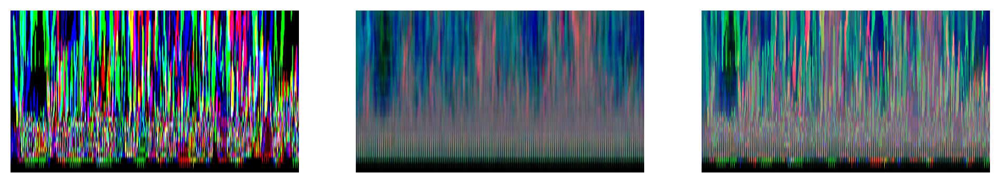

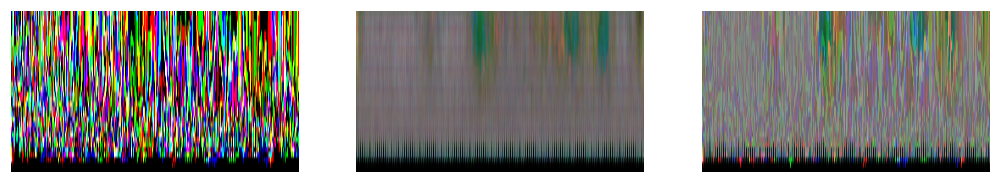

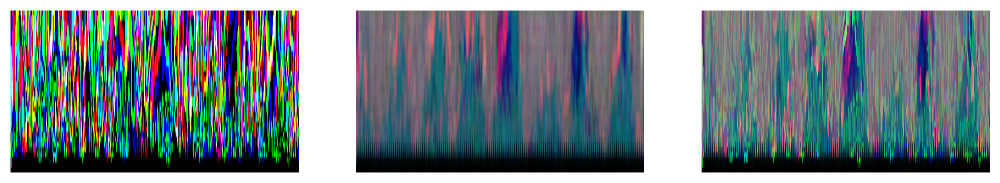

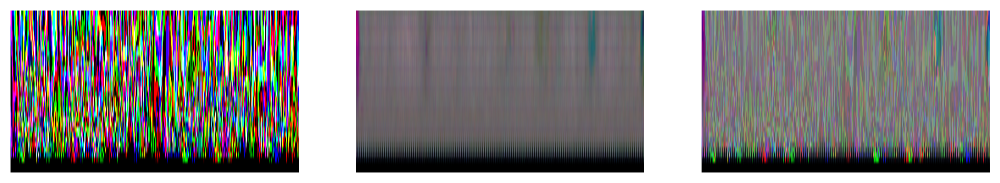

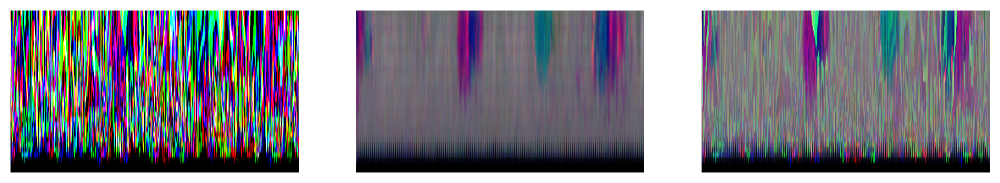

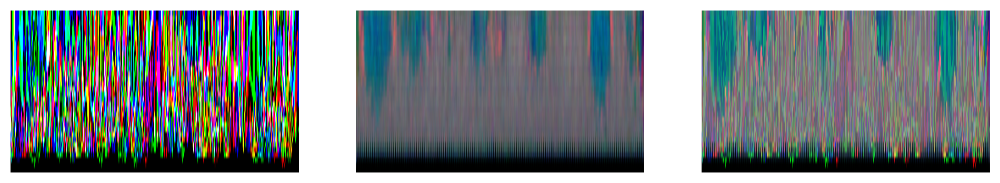

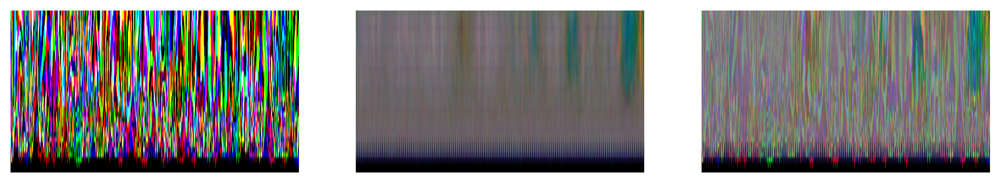

4 of 88 in 56.79 minutes. Using 21.7 of RAM
RAM after AllData: 23.3
RAM after Keeps: 33.4
RAM after Prints: 38.1
Epoch 1/20
195/195 ━━━━━━━━━━━━━━━━━━━━ 17s 89ms/step - loss: 0.2031 - val_loss: 0.2036
Epoch 2/20
195/195 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - loss: 0.2028 - val_loss: 0.2036
Epoch 3/20
195/195 ━━━━━━━━━━━━━━━━━━━━ 10s 53ms/step - loss: 0.2026 - val_loss: 0.2037
Epoch 4/20
195/195 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - loss: 0.2024 - val_loss: 0.2037
Epoch 5/20
195/195 ━━━━━━━━━━━━━━━━━━━━ 10s 53ms/step - loss: 0.2024 - val_loss: 0.2038
Epoch 6/20
195/195 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - loss: 0.2023 - val_loss: 0.2040


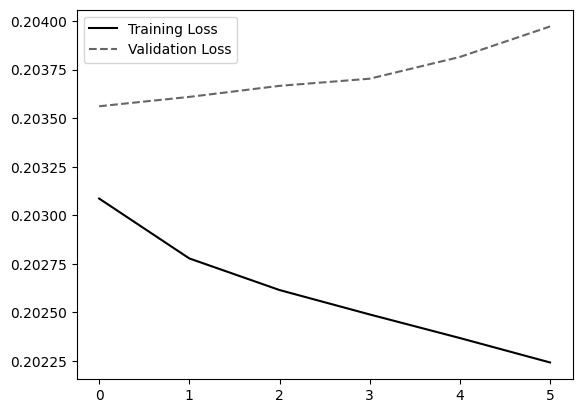

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


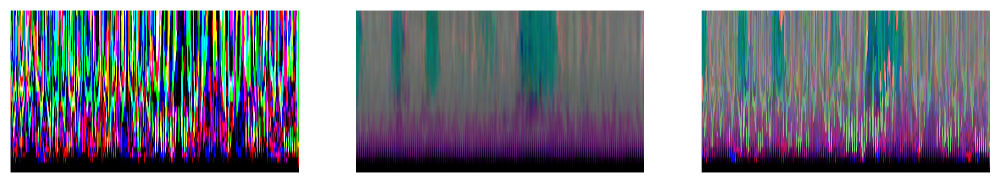

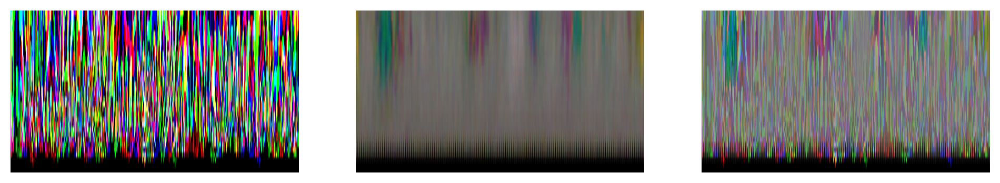

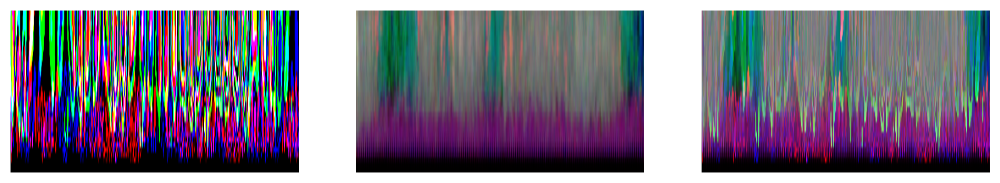

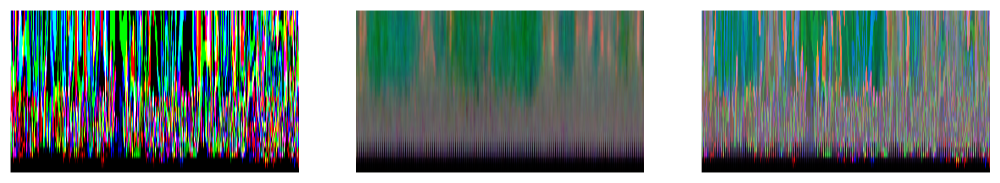

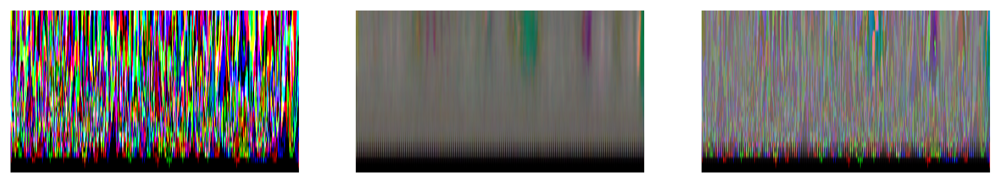

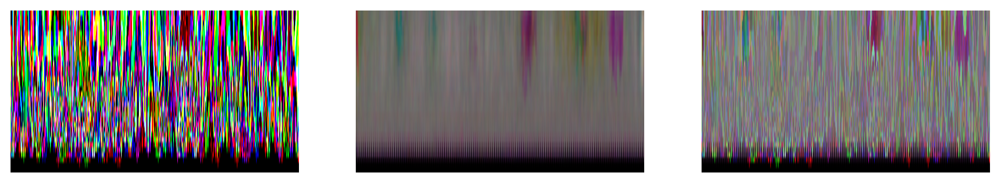

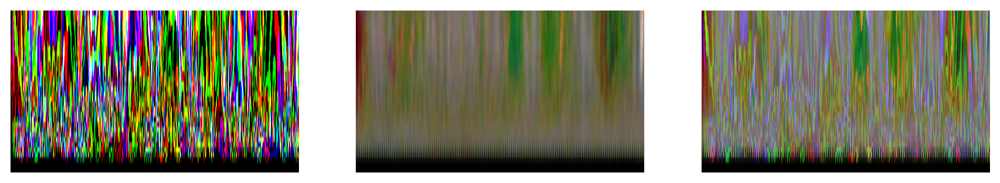

5 of 88 in 69.96 minutes. Using 36.8 of RAM
RAM after AllData: 36.1
RAM after Keeps: 36.6
RAM after Prints: 41.1
Epoch 1/20
182/182 ━━━━━━━━━━━━━━━━━━━━ 16s 88ms/step - loss: 0.2032 - val_loss: 0.2035
Epoch 2/20
182/182 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - loss: 0.2029 - val_loss: 0.2036
Epoch 3/20
182/182 ━━━━━━━━━━━━━━━━━━━━ 10s 53ms/step - loss: 0.2029 - val_loss: 0.2038
Epoch 4/20
182/182 ━━━━━━━━━━━━━━━━━━━━ 9s 52ms/step - loss: 0.2028 - val_loss: 0.2038
Epoch 5/20
182/182 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - loss: 0.2026 - val_loss: 0.2040
Epoch 6/20
182/182 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - loss: 0.2027 - val_loss: 0.2040


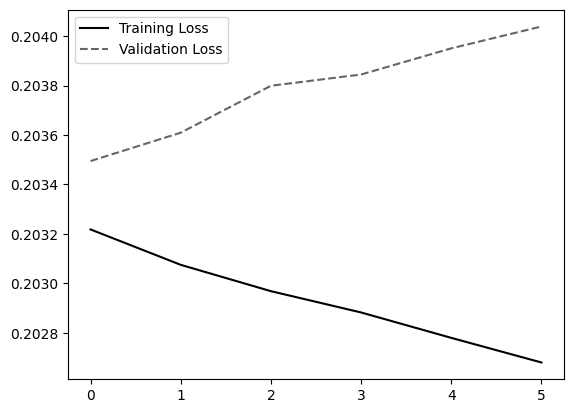

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


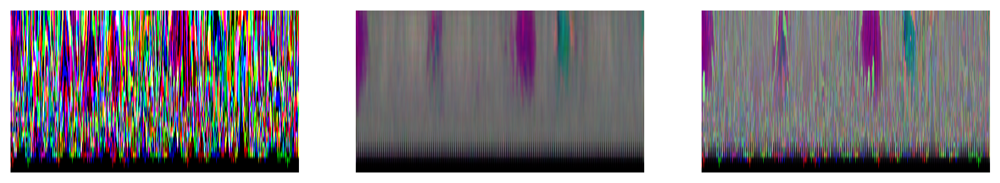

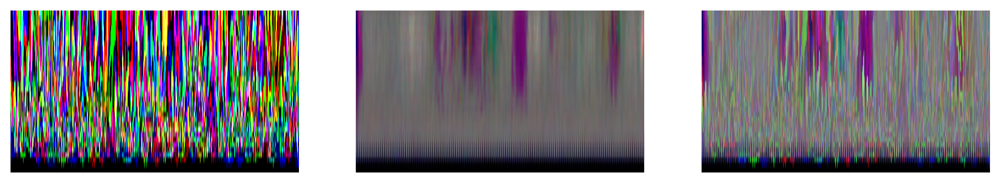

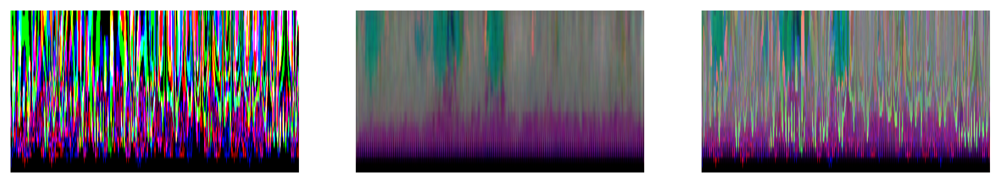

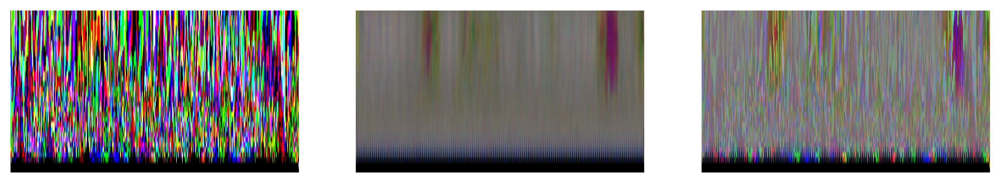

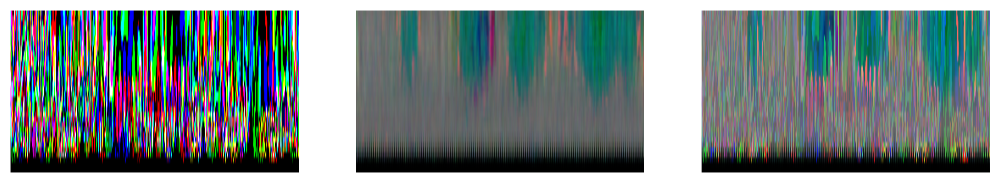

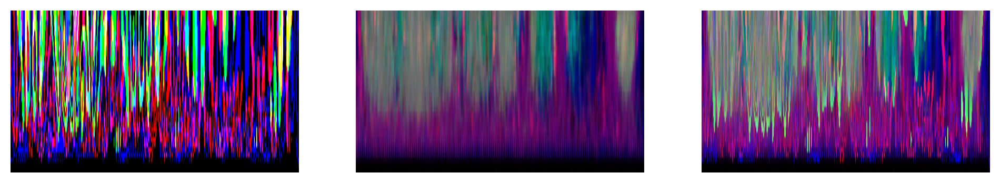

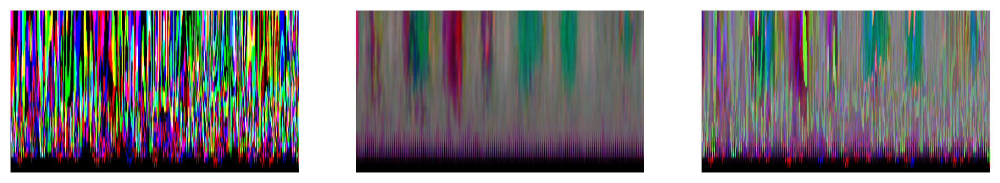

6 of 88 in 82.92 minutes. Using 43.1 of RAM
RAM after AllData: 43.3
RAM after Keeps: 45.7
RAM after Prints: 51.5
Epoch 1/20
240/240 ━━━━━━━━━━━━━━━━━━━━ 21s 89ms/step - loss: 0.3139 - val_loss: 0.3353
Epoch 2/20
240/240 ━━━━━━━━━━━━━━━━━━━━ 12s 52ms/step - loss: 0.3379 - val_loss: 0.3372
Epoch 3/20
240/240 ━━━━━━━━━━━━━━━━━━━━ 13s 52ms/step - loss: 0.3378 - val_loss: 0.3372
Epoch 4/20
240/240 ━━━━━━━━━━━━━━━━━━━━ 12s 52ms/step - loss: 0.3376 - val_loss: 0.3372
Epoch 5/20
240/240 ━━━━━━━━━━━━━━━━━━━━ 13s 52ms/step - loss: 0.3377 - val_loss: 0.3372
Epoch 6/20
240/240 ━━━━━━━━━━━━━━━━━━━━ 13s 53ms/step - loss: 0.3377 - val_loss: 0.3372


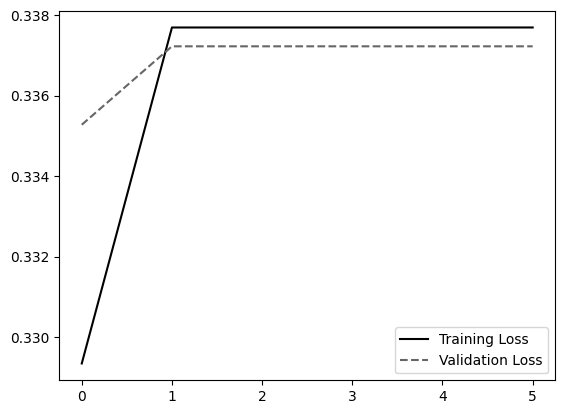

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


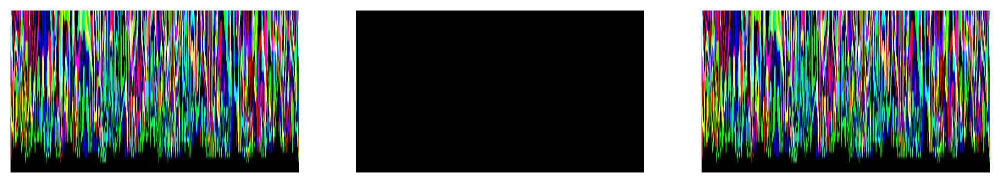

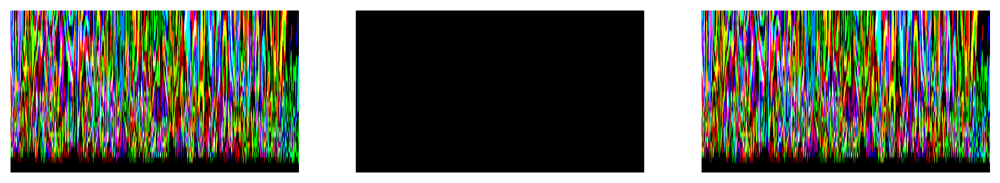

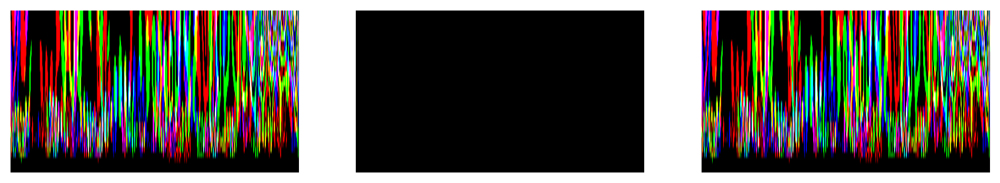

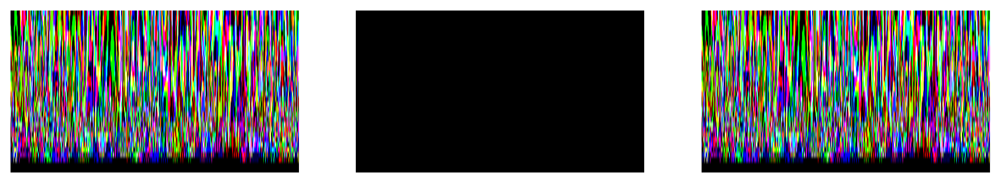

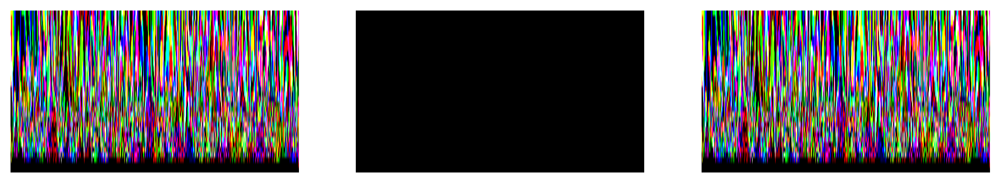

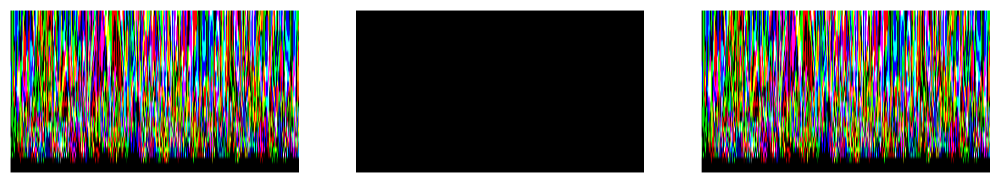

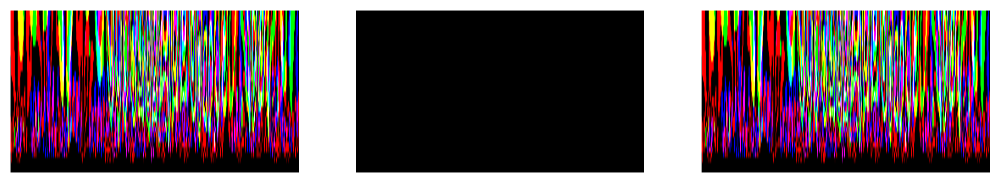

7 of 88 in 98.23 minutes. Using 49.5 of RAM


In [ ]:
if RunTwice:
    LoopsToGetAll = int(len(files)/FilesPerRun)-1
    print(f'Loops Needed: {LoopsToGetAll}')
    for j in range(LoopsToGetAll):
        j+=1
        Mats=[]
        AllDatas = Parallel(n_jobs=ConcurrentFiles)(delayed(runWrapper)(files[(i+j)*7], False, False, 0, ti()) for i in range(FilesPerRun))
        for fileResponse in AllDatas:
            for Mat in fileResponse:
                Mats.append(Mat)
        
        if MemoryProtection:
            del AllDatas
            print('RAM after AllData:', psutil.virtual_memory()[2])        
        lengths = []
        rejects = []
        Keeps = []
        
        for Mat in Mats:
            spm = np.shape(Mat)
            if len(spm) > 1:
                lenM = spm[1]
            else:
                lenM = 1
            if (lenM > 1250):
                lengths.append(lenM)
                Keeps.append(Mat)
            else:
                rejects.append(lenM)
        
        if MemoryProtection:
            del Mats
        
        Prints = []
        
        
        AllPrints = Parallel(n_jobs=8)(delayed(PrintWrap)(Mat) for Mat in Keeps)
        
        if MemoryProtection:
            del Keeps
            print('RAM after Keeps:', psutil.virtual_memory()[2])
        for group in AllPrints:
            for fprint in group:
                Prints.append(fprint[:, ::2, :])
        
        if MemoryProtection:
            del AllPrints
        
        
        random.shuffle(Prints)
        
        TestLength = int(len(Prints)/TestSplit)
        
        for i, image in enumerate(Prints):
            if not isinstance(image, np.ndarray):
                Prints[i] = np.array(image, dtype=np.float32)
            elif image.dtype != np.float32:
                Prints[i] = image.astype(np.float32)
        
        # Stack the images into a single NumPy array
        prints_array = np.stack(Prints, axis=0)
        
        if MemoryProtection:
            del Prints
            print('RAM after Prints:', psutil.virtual_memory()[2])
        # Convert the NumPy array to a TensorFlow tensor
        trX = tf.convert_to_tensor(prints_array)
        
        if MemoryProtection:
            del prints_array
        
        ImageShape = np.shape(trX)
        
        #trX = tensor_prints[:TestLength]  #tf.convert_to_tensor(trainX, dtype=tf.float32)
        
        #teX = tensor_prints[TestLength:]  #tf.convert_to_tensor(testX, dtype=tf.float32)
        
        #if MemoryProtection:
        #    del tensor_prints
        
        checkpoint_callback = CustomModelCheckpoint(
            filepath='/scratch/models/3DFP_1002_'+str(j)+'_{epoch:02d}.keras',
            save_freq=3  
        )
        
        H = autoencoder.fit(
        	trX, trX,
        	validation_split=0.1,
        	epochs=20,
            callbacks=[checkpoint_callback, es_callback],     
        	batch_size=BS)
        
        plt.plot(H.history["loss"], label="Training Loss")
        plt.plot(H.history["val_loss"], label="Validation Loss")
        plt.legend()
        plt.show()

        #random.shuffle(trX)
        
        x_train_pred = autoencoder.predict(trX[:7])
        
        for i in range(7):
            fig, (ax1, ax2, ax3) = plt.subplots(1, 3,figsize=(12,2), dpi=200 )
            ax1.imshow(trX[i], origin='lower',aspect='auto')
            ax1.axis("off")
            ax2.imshow(x_train_pred[i], origin='lower',aspect='auto')
            ax2.axis("off")
            ax3.imshow(np.abs(trX[i]-x_train_pred[i]), origin='lower',aspect='auto')
            ax3.axis("off")
            plt.show()

        del trX, x_train_pred

        if j%LR_PeriodGrow == 0:
            LR_Current *= LR_Expand
        else:
            LR_Current *= LR_Decay
            
        autoencoder.optimizer.learning_rate = LR_Current
    
        print(f'{j} of {LoopsToGetAll} in {int((ti()-toc)/.6)/100} minutes. Using { psutil.virtual_memory()[2]} of RAM')